In [1]:
import pandas as pd
import datetime
import math
import numpy as np
import hashlib
import scipy
import matplotlib.pyplot as plt
import matplotlib.mlab as mlab
import matplotlib.cm as cm

%matplotlib inline

import warnings
warnings.filterwarnings('ignore')

import seaborn as sns
sns.set(style="ticks", color_codes=True, font_scale=1.5)
color = sns.color_palette()
sns.set_style('darkgrid')

from mpl_toolkits.mplot3d import Axes3D

import plotly as py
import plotly.graph_objs as go
py.offline.init_notebook_mode()

from scipy import stats
from scipy.stats import skew, norm, probplot, boxcox
from sklearn import preprocessing
import math

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

In [2]:
order = pd.read_csv('olist_orders_dataset.csv')
cust = pd.read_csv('olist_customers_dataset.csv')
payment = pd.read_csv('olist_order_payments_dataset.csv')
order_items = pd.read_csv('olist_order_items_dataset.csv')

In [3]:
print(f"olist_orders_dataset: {order.columns}")
print(f"olist_customers_dataset: {cust.columns}")
print(f"olist_order_payments_dataset: {payment.columns}")
print(f"olist_order_items_dataset: {order_items.columns}")

olist_orders_dataset: Index(['order_id', 'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date'],
      dtype='object')
olist_customers_dataset: Index(['customer_id', 'customer_unique_id', 'customer_zip_code_prefix',
       'customer_city', 'customer_state'],
      dtype='object')
olist_order_payments_dataset: Index(['order_id', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value'],
      dtype='object')
olist_order_items_dataset: Index(['order_id', 'order_item_id', 'product_id', 'seller_id',
       'shipping_limit_date', 'price', 'freight_value'],
      dtype='object')


In [4]:
# creating master dataframe 
payment.head()
df1 = payment.merge(order_items, on='order_id')
df2 = df1.merge(order, on='order_id')
df = df2.merge(cust, on='customer_id')
print(df.shape)

(117601, 22)


In [5]:
df.head()

,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33,1,af74cc53dcffc8384b29e7abfa41902b,213b25e6f54661939f11710a6fddb871,2018-05-02 22:15:09,79.80,...,delivered,2018-04-25 22:01:49,2018-04-25 22:15:09,2018-05-02 15:20:00,2018-05-09 17:36:51,2018-05-22 00:00:00,708ab75d2a007f0564aedd11139c7708,39801,teofilo otoni,MG
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39,1,a630cc320a8c872f9de830cf121661a3,eaf6d55068dea77334e8477d3878d89e,2018-07-02 11:18:58,17.00,...,delivered,2018-06-26 11:01:38,2018-06-26 11:18:58,2018-06-28 14:18:00,2018-06-29 20:32:09,2018-07-16 00:00:00,a8b9d3a27068454b1c98cc67d4e31e6f,2422,sao paulo,SP
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71,1,2028bf1b01cafb2d2b1901fca4083222,cc419e0650a3c5ba77189a1882b7556a,2017-12-26 09:52:34,56.99,...,delivered,2017-12-12 11:19:55,2017-12-14 09:52:34,2017-12-15 20:13:22,2017-12-18 17:24:41,2018-01-04 00:00:00,6f70c0b2f7552832ba46eb57b1c5651e,2652,sao paulo,SP
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78,1,548e5bfe28edceab6b51fa707cc9556f,da8622b14eb17ae2831f4ac5b9dab84a,2017-12-12 12:13:20,89.90,...,delivered,2017-12-06 12:04:06,2017-12-06 12:13:20,2017-12-07 20:28:28,2017-12-21 01:35:51,2018-01-04 00:00:00,87695ed086ebd36f20404c82d20fca87,36060,juiz de fora,MG
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45,1,386486367c1f9d4f587a8864ccb6902b,cca3071e3e9bb7d12640c9fbe2301306,2018-05-31 16:14:41,113.57,...,delivered,2018-05-21 13:59:17,2018-05-21 16:14:41,2018-05-22 11:46:00,2018-06-01 21:44:53,2018-06-13 00:00:00,4291db0da71914754618cd789aebcd56,18570,conchas,SP


In [6]:
df.isnull().sum()

order_id                            0
payment_sequential                  0
payment_type                        0
payment_installments                0
payment_value                       0
order_item_id                       0
product_id                          0
seller_id                           0
shipping_limit_date                 0
price                               0
freight_value                       0
customer_id                         0
order_status                        0
order_purchase_timestamp            0
order_approved_at                  15
order_delivered_carrier_date     1245
order_delivered_customer_date    2567
order_estimated_delivery_date       0
customer_unique_id                  0
customer_zip_code_prefix            0
customer_city                       0
customer_state                      0
dtype: int64

In [7]:
# converting date columns to datetime
date_columns = ['shipping_limit_date', 'order_purchase_timestamp', 'order_approved_at', 'order_delivered_carrier_date', 'order_delivered_customer_date', 'order_estimated_delivery_date']
for col in date_columns:
    df[col] = pd.to_datetime(df[col], format='%Y-%m-%d %H:%M:%S')
    
# cleaning up name columns
df['customer_city'] = df['customer_city'].str.title()
df['payment_type'] = df['payment_type'].str.replace('_', ' ').str.title()
# engineering new/essential columns
df['delivery_against_estimated'] = (df['order_estimated_delivery_date'] - df['order_delivered_customer_date']).dt.days
df['order_purchase_year'] = df.order_purchase_timestamp.apply(lambda x: x.year)
df['order_purchase_month'] = df.order_purchase_timestamp.apply(lambda x: x.month)
df['order_purchase_dayofweek'] = df.order_purchase_timestamp.apply(lambda x: x.dayofweek)
df['order_purchase_hour'] = df.order_purchase_timestamp.apply(lambda x: x.hour)
df['order_purchase_day'] = df['order_purchase_dayofweek'].map({0:'Mon',1:'Tue',2:'Wed',3:'Thu',4:'Fri',5:'Sat',6:'Sun'})
df['order_purchase_mon'] = df.order_purchase_timestamp.apply(lambda x: x.month).map({1:'Jan',2:'Feb',3:'Mar',4:'Apr',5:'May',6:'Jun',7:'Jul',8:'Aug',9:'Sep',10:'Oct',11:'Nov',12:'Dec'})
# Changing the month attribute for correct ordenation
df['month_year'] = df['order_purchase_month'].astype(str).apply(lambda x: '0' + x if len(x) == 1 else x)
df['month_year'] = df['order_purchase_year'].astype(str) + '-' + df['month_year'].astype(str)
#creating year month column
df['month_y'] = df['order_purchase_timestamp'].map(lambda date: 100*date.year + date.month)

In [8]:
# displaying summary staticstics of columns
df.describe(include='all')

,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,customer_state,delivery_against_estimated,order_purchase_year,order_purchase_month,order_purchase_dayofweek,order_purchase_hour,order_purchase_day,order_purchase_mon,month_year,month_y
count,117601,117601.000000,117601,117601.000000,117601.000000,117601.000000,117601,117601,117601,117601.000000,...,117601,115034.000000,117601.000000,117601.000000,117601.000000,117601.000000,117601,117601,117601,117601.000000
unique,98665,NaN,4,NaN,NaN,NaN,32951,3095,93317,NaN,...,27,NaN,NaN,NaN,NaN,NaN,7,12,24,NaN
top,895ab968e7bb0d5659d16cd74cd1650c,NaN,Credit Card,NaN,NaN,NaN,aca2eb7d00ea1a7b8ebd4e68314663af,4a3ca9315b744ce9f8e9374361493884,2017-08-14 20:43:31,NaN,...,SP,NaN,NaN,NaN,NaN,NaN,Mon,Aug,2017-11,NaN
freq,63,NaN,86769,NaN,NaN,NaN,536,2133,63,NaN,...,49566,NaN,NaN,NaN,NaN,NaN,19130,12632,9016,NaN
first,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2016-09-19 00:15:34,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2020-04-09 22:35:08,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,1.093528,NaN,2.939482,172.686752,1.195900,NaN,NaN,NaN,120.824783,...,NaN,11.043326,2017.538193,6.028129,2.745750,14.760002,NaN,NaN,NaN,201759.847399
std,NaN,0.726692,NaN,2.774223,267.592290,0.697706,NaN,NaN,NaN,184.479323,...,NaN,10.162307,0.505065,3.229579,1.961257,5.325670,NaN,NaN,NaN,48.798820
min,NaN,1.000000,NaN,0.000000,0.000000,1.000000,NaN,NaN,NaN,0.850000,...,NaN,-189.000000,2016.000000,1.000000,0.000000,0.000000,NaN,NaN,NaN,201609.000000
25%,NaN,1.000000,NaN,1.000000,60.870000,1.000000,NaN,NaN,NaN,39.900000,...,NaN,6.000000,2017.000000,3.000000,1.000000,11.000000,NaN,NaN,NaN,201709.000000


In [9]:
# displaying missing value counts and corresponding percentage against total observations
missing_values = df.isnull().sum().sort_values(ascending = False)
percentage = (df.isnull().sum()/df.isnull().count()*100).sort_values(ascending = False)
pd.concat([missing_values, percentage], axis=1, keys=['Values', 'Percentage']).transpose()

,order_delivered_customer_date,delivery_against_estimated,order_delivered_carrier_date,order_approved_at,month_year,order_purchase_mon,order_purchase_day,order_purchase_hour,order_purchase_dayofweek,order_purchase_month,...,freight_value,price,shipping_limit_date,seller_id,product_id,order_item_id,payment_value,payment_installments,payment_type,month_y
Values,2567.000000,2567.000000,1245.000000,15.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Percentage,2.182805,2.182805,1.058664,0.012755,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [10]:
# dropping missing values
df.dropna(inplace=True)
df.isnull().values.any()

False

In [11]:
# displaying dataframe info
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 115018 entries, 0 to 117600
Data columns (total 31 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   order_id                       115018 non-null  object        
 1   payment_sequential             115018 non-null  int64         
 2   payment_type                   115018 non-null  object        
 3   payment_installments           115018 non-null  int64         
 4   payment_value                  115018 non-null  float64       
 5   order_item_id                  115018 non-null  int64         
 6   product_id                     115018 non-null  object        
 7   seller_id                      115018 non-null  object        
 8   shipping_limit_date            115018 non-null  datetime64[ns]
 9   price                          115018 non-null  float64       
 10  freight_value                  115018 non-null  float64       
 11  

In [12]:
df['month_year'].min()

'2016-10'

In [13]:
df['month_year'].max()

'2018-08'

In [14]:
#calculate Revenue for each row and create a new dataframe with YearMonth - Revenue columns
df_revenue = df.groupby(['month_year'])['payment_value'].sum().reset_index()
df_revenue

,month_year,payment_value
0,2016-10,62591.65
1,2016-12,19.62
2,2017-01,176376.56
3,2017-02,323815.95
4,2017-03,505735.83
5,2017-04,456108.32
6,2017-05,701119.60
7,2017-06,585400.98
8,2017-07,716069.98
9,2017-08,842689.94


In [15]:
#calculating for monthly revenie growth rate
# using pct_change() function to see monthly percentage change
df_revenue['MonthlyGrowth'] = df_revenue['payment_value'].pct_change()

df_revenue

,month_year,payment_value,MonthlyGrowth
0,2016-10,62591.65,NaN
1,2016-12,19.62,-0.999687
2,2017-01,176376.56,8988.630989
3,2017-02,323815.95,0.835935
4,2017-03,505735.83,0.561800
5,2017-04,456108.32,-0.098129
6,2017-05,701119.60,0.537178
7,2017-06,585400.98,-0.165048
8,2017-07,716069.98,0.223213
9,2017-08,842689.94,0.176826


In [16]:
import datetime
#creates a generic user dataframe to keep CustomerID and new segmentation scores
df_user = pd.DataFrame(df['customer_unique_id'])
df_user.columns = ['customer_unique_id']

#gets the max purchase date for each customer and create a dataframe with it
df_max_purchase = df.groupby('customer_unique_id').order_purchase_timestamp.max().reset_index() 
df_max_purchase.columns = ['customer_unique_id', 'MaxPurchaseDate']


#we take our observation point as the max purchase date in our dataset
df_max_purchase['Recency'] = (df_max_purchase['MaxPurchaseDate'].max() - df_max_purchase['MaxPurchaseDate']).dt.days

#merge this dataframe to our new user dataframe
df_user = pd.merge(df_user, df_max_purchase[['customer_unique_id','Recency']], on='customer_unique_id')

df_user.head()

,customer_unique_id,Recency
0,708ab75d2a007f0564aedd11139c7708,125
1,a8b9d3a27068454b1c98cc67d4e31e6f,64
2,6f70c0b2f7552832ba46eb57b1c5651e,260
3,87695ed086ebd36f20404c82d20fca87,266
4,4291db0da71914754618cd789aebcd56,28


In [17]:
# getting summary statistics of the recency table
df_user.Recency.describe()

count    115018.000000
mean        237.228564
std         152.514177
min           0.000000
25%         113.000000
50%         218.000000
75%         345.000000
max         694.000000
Name: Recency, dtype: float64

In [18]:
def QQ_plot(data, measure):
    fig = plt.figure(figsize=(20,7))

    #Get the fitted parameters used by the function
    (mu, sigma) = norm.fit(data)

    #Kernel Density plot
    fig1 = fig.add_subplot(121)
    sns.distplot(data, fit=norm)
    fig1.set_title(measure + ' Distribution ( mu = {:.2f} and sigma = {:.2f} )'.format(mu, sigma), loc='center')
    fig1.set_xlabel(measure)
    fig1.set_ylabel('Frequency')

#     #QQ plot
#     fig2 = fig.add_subplot(122)
#     res = probplot(data, plot=fig2)
#     fig2.set_title(measure + ' Probability Plot (skewness: {:.6f} and kurtosis: {:.6f} )'.format(data.skew(), data.kurt()), loc='center')

    plt.tight_layout()
    plt.show()

In [19]:
#get order counts for each user and create a dataframe with it
df_frequency = df.groupby('customer_unique_id').order_purchase_timestamp.count().reset_index()
df_frequency.columns = ['customer_unique_id','Frequency']

#add this data to our main dataframe
df_user = pd.merge(df_user, df_frequency, on='customer_unique_id')

df_user.head()

,customer_unique_id,Recency,Frequency
0,708ab75d2a007f0564aedd11139c7708,125,1
1,a8b9d3a27068454b1c98cc67d4e31e6f,64,1
2,6f70c0b2f7552832ba46eb57b1c5651e,260,1
3,87695ed086ebd36f20404c82d20fca87,266,1
4,4291db0da71914754618cd789aebcd56,28,3


In [20]:
# getting summary statistics of the recency table
df_user.Frequency.describe()

count    115018.000000
mean          1.777670
std           2.771438
min           1.000000
25%           1.000000
50%           1.000000
75%           2.000000
max          75.000000
Name: Frequency, dtype: float64

In [21]:
#calculate revenue for each customer
df_revenue = df.groupby('customer_unique_id').payment_value.sum().reset_index()

#merge it with our main dataframe
df_user = pd.merge(df_user, df_revenue, on='customer_unique_id')

df_user.head()

,customer_unique_id,Recency,Frequency,payment_value
0,708ab75d2a007f0564aedd11139c7708,125,1,99.33
1,a8b9d3a27068454b1c98cc67d4e31e6f,64,1,24.39
2,6f70c0b2f7552832ba46eb57b1c5651e,260,1,65.71
3,87695ed086ebd36f20404c82d20fca87,266,1,107.78
4,4291db0da71914754618cd789aebcd56,28,3,627.74


In [22]:
df_user.rename(columns={'payment_value': 'Monetary'}, inplace=True, errors='raise')
df_user.head()

,customer_unique_id,Recency,Frequency,Monetary
0,708ab75d2a007f0564aedd11139c7708,125,1,99.33
1,a8b9d3a27068454b1c98cc67d4e31e6f,64,1,24.39
2,6f70c0b2f7552832ba46eb57b1c5651e,260,1,65.71
3,87695ed086ebd36f20404c82d20fca87,266,1,107.78
4,4291db0da71914754618cd789aebcd56,28,3,627.74


In [23]:
# getting summary statistics of the recency table
df_user.Monetary.describe()

count    115018.000000
mean        375.328291
std        1665.299621
min           9.590000
25%          70.040000
50%         133.530000
75%         276.960000
max      109312.640000
Name: Monetary, dtype: float64

### Plotting the distribution and Kernel Density Plot for R, F and M values

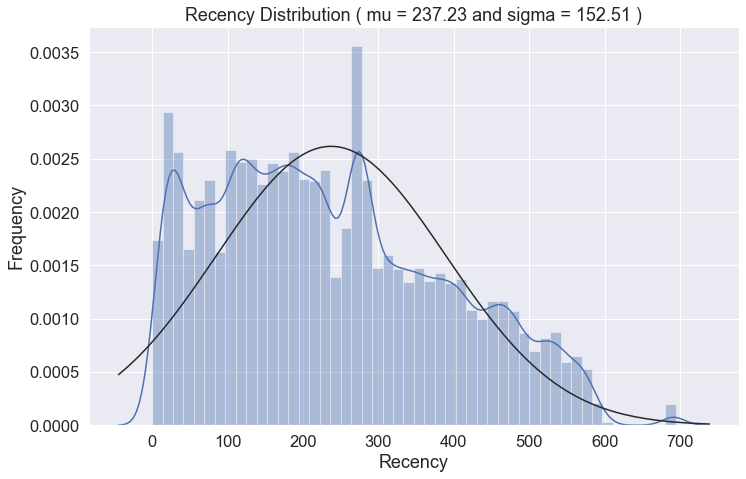

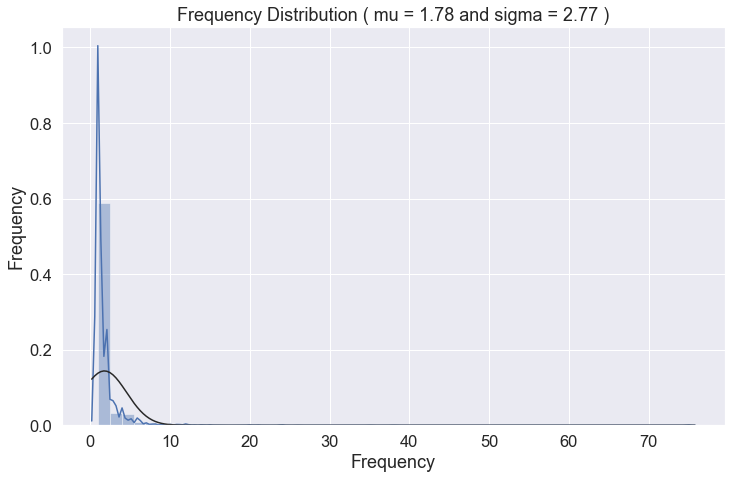

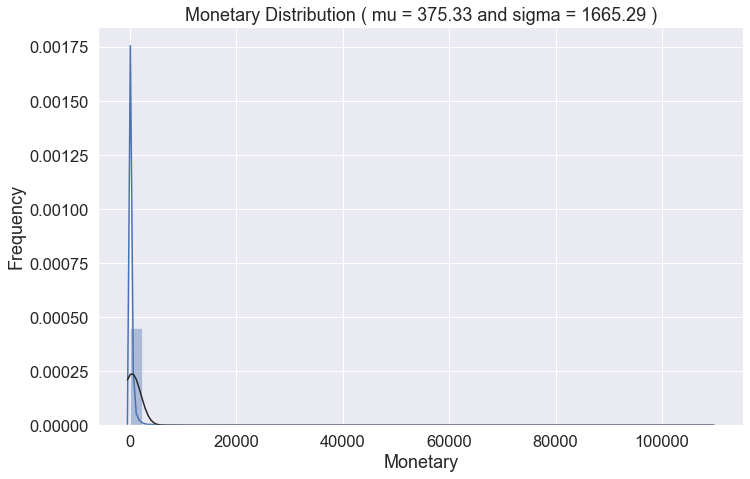

In [24]:
QQ_plot(df_user.Recency, 'Recency')
QQ_plot(df_user.Frequency, 'Frequency')
QQ_plot(df_user.Monetary, 'Monetary')

### Log Transformation on skewed data

In [25]:
rfm_log = df_user.copy()
for i in rfm_log.columns[1:]:
    rfm_log[i] = np.log(rfm_log[i])
    
rfm_log

,customer_unique_id,Recency,Frequency,Monetary
0,708ab75d2a007f0564aedd11139c7708,4.828314,0.000000,4.598448
1,a8b9d3a27068454b1c98cc67d4e31e6f,4.158883,0.000000,3.194173
2,6f70c0b2f7552832ba46eb57b1c5651e,5.560682,0.000000,4.185251
3,87695ed086ebd36f20404c82d20fca87,5.583496,0.000000,4.680092
4,4291db0da71914754618cd789aebcd56,3.332205,1.098612,6.442126
...,...,...,...,...
115013,18f40b803060d9883643b7e64e91628e,5.164786,0.000000,5.268425
115014,13f283df2f4760f22b57830865761d07,4.653960,0.000000,5.293003
115015,b6027ac07fb76ebca8c97b1887865aee,5.153292,0.000000,5.895256
115016,b84dc68f02f122a88d7e7bbd37b06204,3.044522,0.000000,5.912259


### Checking distribution after log transformation

In [26]:
rfm_log.shape

(115018, 4)

In [27]:
rfm_log.replace([np.inf, -np.inf], np.nan, inplace=True)
# rfm_log[rfm_log==np.inf]=np.nan
rfm_log.dropna(inplace=True)

In [28]:
rfm_log = rfm_log.reset_index()
rfm_log

,index,customer_unique_id,Recency,Frequency,Monetary
0,0,708ab75d2a007f0564aedd11139c7708,4.828314,0.000000,4.598448
1,1,a8b9d3a27068454b1c98cc67d4e31e6f,4.158883,0.000000,3.194173
2,2,6f70c0b2f7552832ba46eb57b1c5651e,5.560682,0.000000,4.185251
3,3,87695ed086ebd36f20404c82d20fca87,5.583496,0.000000,4.680092
4,4,4291db0da71914754618cd789aebcd56,3.332205,1.098612,6.442126
...,...,...,...,...,...
114970,115013,18f40b803060d9883643b7e64e91628e,5.164786,0.000000,5.268425
114971,115014,13f283df2f4760f22b57830865761d07,4.653960,0.000000,5.293003
114972,115015,b6027ac07fb76ebca8c97b1887865aee,5.153292,0.000000,5.895256
114973,115016,b84dc68f02f122a88d7e7bbd37b06204,3.044522,0.000000,5.912259


In [29]:
rfm_log.describe()

,index,Recency,Frequency,Monetary
count,114975.000000,114975.000000,114975.000000,114975.000000
mean,57509.511302,5.149221,0.321875,5.030046
std,33204.666797,0.960847,0.563412,1.089654
min,0.000000,0.000000,0.000000,2.260721
25%,28750.500000,4.727388,0.000000,4.249209
50%,57511.000000,5.384495,0.000000,4.894326
75%,86264.500000,5.843544,0.693147,5.623873
max,115017.000000,6.542472,4.317488,11.601967


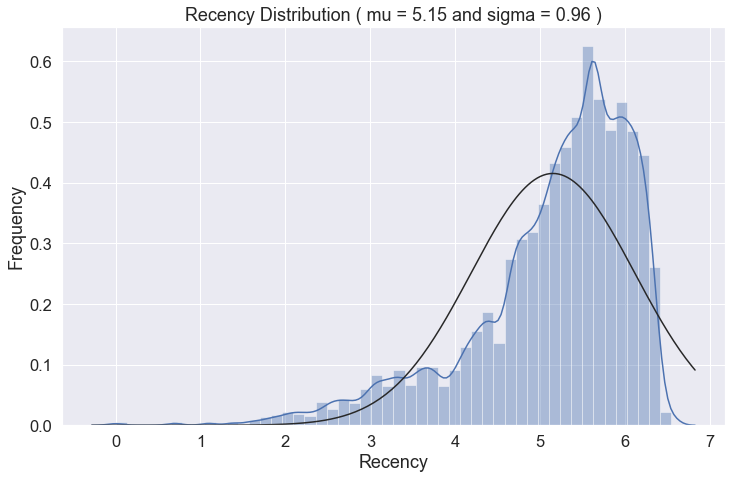

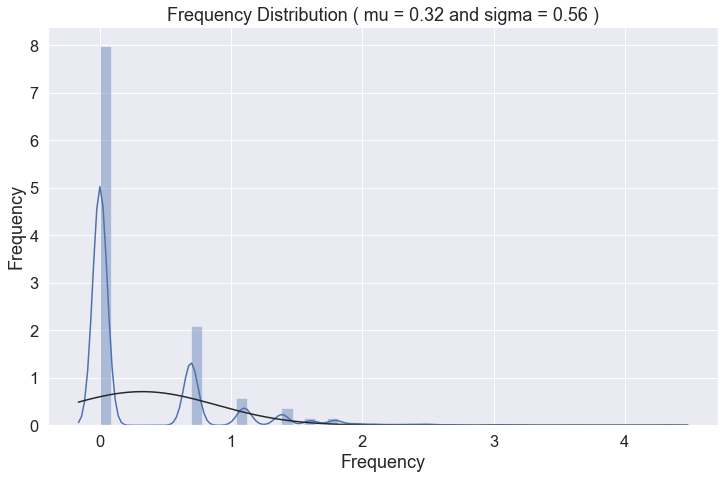

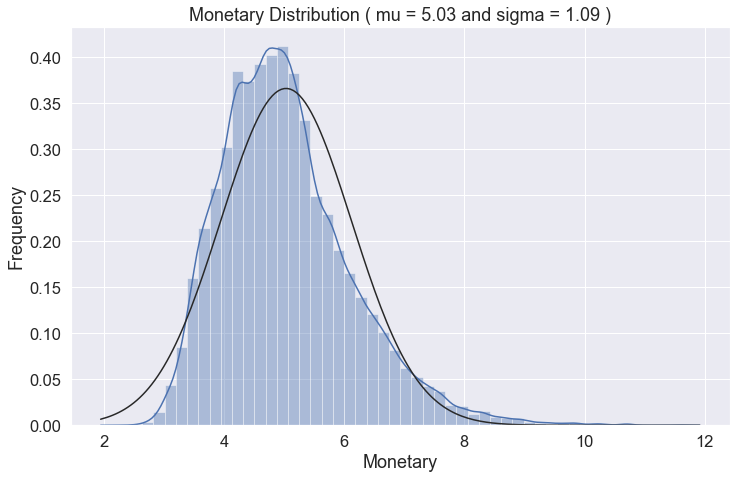

In [30]:
QQ_plot(rfm_log.Recency, 'Recency')
QQ_plot(rfm_log.Frequency, 'Frequency')
QQ_plot(rfm_log.Monetary, 'Monetary')

### Scaling the log transformed values

In [31]:
feature_vector = ['Recency','Frequency','Monetary',]

X_subset = rfm_log[feature_vector] #.as_matrix()
X_subset.replace([np.inf, -np.inf], np.nan, inplace=True)

scaler = preprocessing.StandardScaler().fit(X_subset)

X_scaled = scaler.transform(X_subset)

X_scaled_df = pd.DataFrame(X_scaled, columns=X_subset.columns)
round(X_scaled_df.describe().T,2)

,count,mean,std,min,25%,50%,75%,max
Recency,114975.0,0.0,1.0,-5.36,-0.44,0.24,0.72,1.45
Frequency,114975.0,0.0,1.0,-0.57,-0.57,-0.57,0.66,7.09
Monetary,114975.0,0.0,1.0,-2.54,-0.72,-0.12,0.54,6.03


In [32]:
X_scaled_df

,Recency,Frequency,Monetary
0,-0.333986,-0.571299,-0.396089
1,-1.030698,-0.571299,-1.684829
2,0.428228,-0.571299,-0.775291
3,0.451973,-0.571299,-0.321162
4,-1.891066,1.378636,1.295904
...,...,...,...
114970,0.016199,-0.571299,0.218767
114971,-0.515444,-0.571299,0.241323
114972,0.004236,-0.571299,0.794027
114973,-2.190472,-0.571299,0.809631


### Distribution after scaling

In [33]:
X_scaled_df.replace([np.inf, -np.inf], np.nan, inplace=True)
X_scaled_df.dropna(inplace=True)

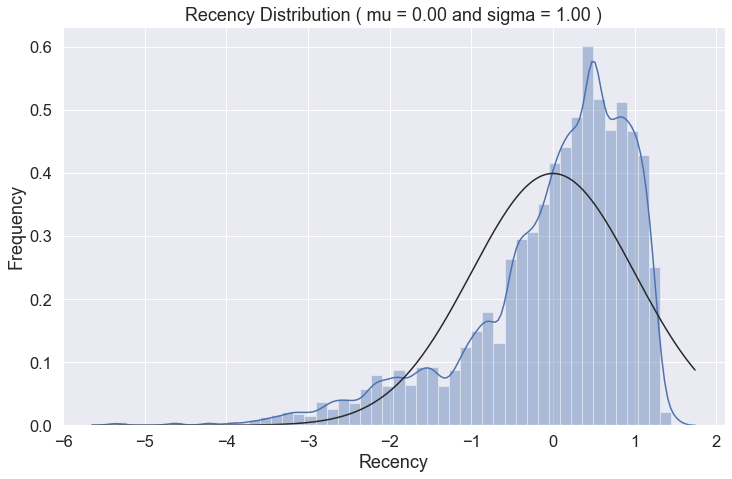

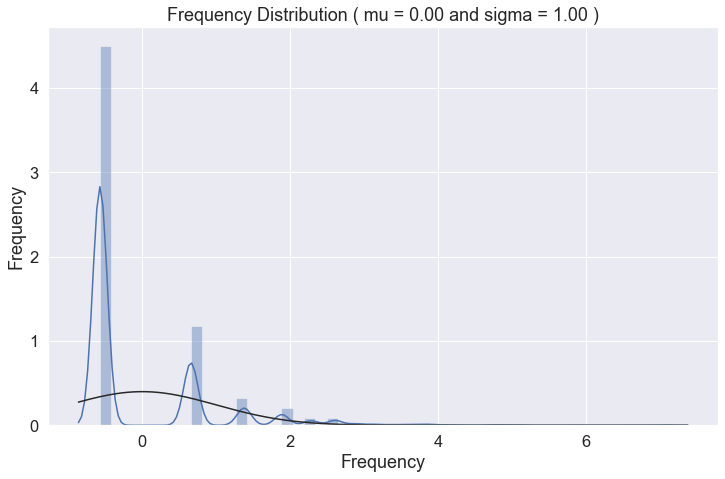

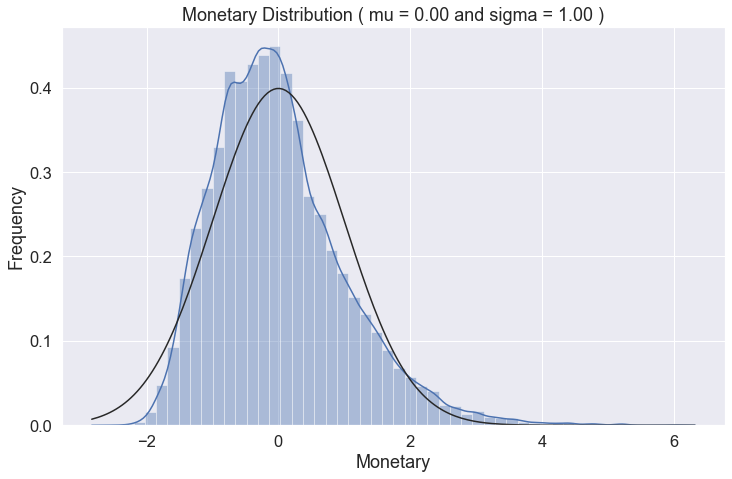

In [34]:
QQ_plot(X_scaled_df.Recency,'Recency')
QQ_plot(X_scaled_df.Frequency,'Frequency')
QQ_plot(X_scaled_df.Monetary,'Monetary')

In [35]:
X_scaled_df.head()

,Recency,Frequency,Monetary
0,-0.333986,-0.571299,-0.396089
1,-1.030698,-0.571299,-1.684829
2,0.428228,-0.571299,-0.775291
3,0.451973,-0.571299,-0.321162
4,-1.891066,1.378636,1.295904


<AxesSubplot:xlabel='Recency', ylabel='Monetary'>

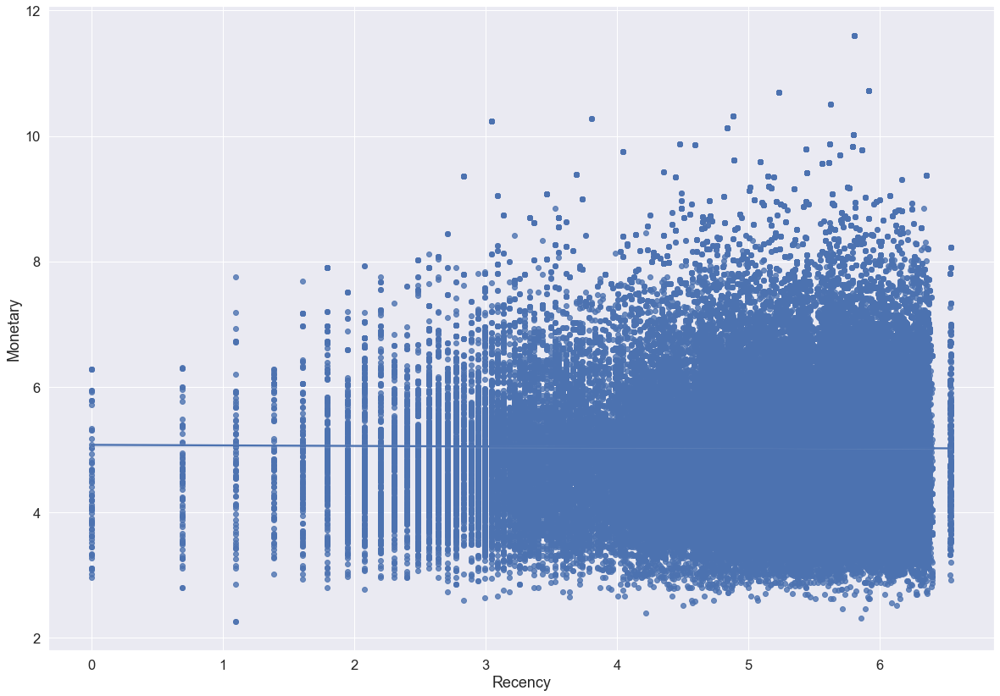

In [36]:
fig = plt.figure(figsize=(20,14))
sns.regplot(x='Recency', y='Monetary', data=rfm_log)

<AxesSubplot:xlabel='Frequency', ylabel='Monetary'>

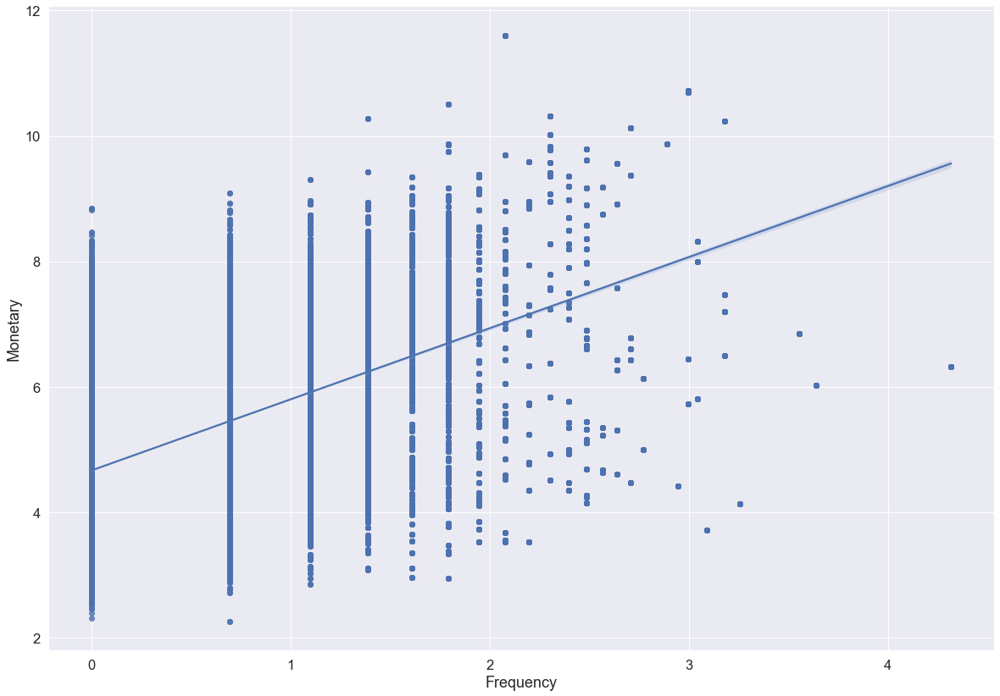

In [37]:
fig = plt.figure(figsize=(20,14))
sns.regplot(x='Frequency', y='Monetary', data=rfm_log)

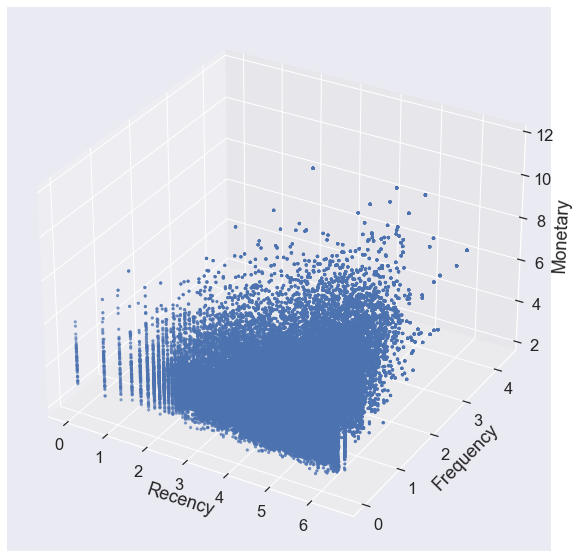

In [38]:
fig = plt.figure(figsize=(20, 10))
ax = fig.add_subplot(111, projection='3d')

xs =rfm_log.Recency
ys = rfm_log.Frequency
zs = rfm_log.Monetary
ax.scatter(xs, ys, zs, s=5)

ax.set_xlabel('Recency')
ax.set_ylabel('Frequency')
ax.set_zlabel('Monetary')

plt.show()

## Elbow method to find no of clusters

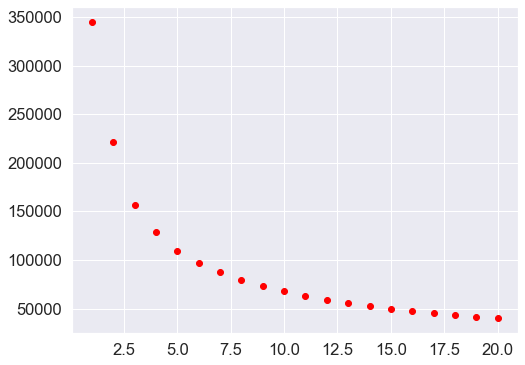

In [39]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score


cl = 20
corte = 0.1

anterior = 100000000000000
cost = [] 
K_best = cl

for k in range (1, cl+1):
    # Create a kmeans model on our data, using k clusters.  random_state helps ensure that the algorithm returns the same results each time.
    model = KMeans(
        n_clusters=k, 
        init='k-means++', #'random',
        n_init=10,
        max_iter=300,
        tol=1e-04,
        random_state=101)

    model = model.fit(X_scaled_df)

    # labels for clusters -- the first cluster has label 0, and the second has label 1.
    labels = model.labels_
 
    # Sum of distances of samples to their closest cluster center
    interia = model.inertia_
    
    if (K_best == cl) and (((anterior - interia)/anterior) < corte): K_best = k - 1
    cost.append(interia)
    anterior = interia

plt.figure(figsize=(8, 6))
plt.scatter(range (1, cl+1), cost, c='red')
plt.show()

# Create a kmeans model with the best K.
# print('The best K sugest: ',K_best)
model = KMeans(n_clusters=K_best, init='k-means++', n_init=10,max_iter=300, tol=1e-04, random_state=101)

# scaling the data to normalize
model = model.fit(X_scaled_df)

# fitted labels for clusters -- the first cluster has label 0, and the second has label 1.
labels = model.labels_

### Inverse scaling

In [40]:
X_scaled_df

,Recency,Frequency,Monetary
0,-0.333986,-0.571299,-0.396089
1,-1.030698,-0.571299,-1.684829
2,0.428228,-0.571299,-0.775291
3,0.451973,-0.571299,-0.321162
4,-1.891066,1.378636,1.295904
...,...,...,...
114970,0.016199,-0.571299,0.218767
114971,-0.515444,-0.571299,0.241323
114972,0.004236,-0.571299,0.794027
114973,-2.190472,-0.571299,0.809631


In [41]:
features = ['Recency','Frequency','Monetary']

rfm_inverse_transform = scaler.inverse_transform(X_scaled_df)
rfm_inverse_transform = pd.DataFrame(np.exp(rfm_inverse_transform),columns=features)
rfm_inverse_transform

,Recency,Frequency,Monetary
0,125.0,1.0,99.33
1,64.0,1.0,24.39
2,260.0,1.0,65.71
3,266.0,1.0,107.78
4,28.0,3.0,627.74
...,...,...,...
114970,175.0,1.0,194.11
114971,105.0,1.0,198.94
114972,173.0,1.0,363.31
114973,21.0,1.0,369.54


In [42]:
rfm_inverse_transform.describe()

,Recency,Frequency,Monetary
count,114975.000000,114975.000000,114975.000000
mean,237.317286,1.777491,375.272364
std,152.473663,2.771765,1665.543011
min,1.000000,1.000000,9.590000
25%,113.000000,1.000000,70.050000
50%,218.000000,1.000000,133.530000
75%,345.000000,2.000000,276.960000
max,694.000000,75.000000,109312.640000


In [43]:
df_user.describe()

,Recency,Frequency,Monetary
count,115018.000000,115018.000000,115018.000000
mean,237.228564,1.777670,375.328291
std,152.514177,2.771438,1665.299621
min,0.000000,1.000000,9.590000
25%,113.000000,1.000000,70.040000
50%,218.000000,1.000000,133.530000
75%,345.000000,2.000000,276.960000
max,694.000000,75.000000,109312.640000


In [44]:
df_user

,customer_unique_id,Recency,Frequency,Monetary
0,708ab75d2a007f0564aedd11139c7708,125,1,99.33
1,a8b9d3a27068454b1c98cc67d4e31e6f,64,1,24.39
2,6f70c0b2f7552832ba46eb57b1c5651e,260,1,65.71
3,87695ed086ebd36f20404c82d20fca87,266,1,107.78
4,4291db0da71914754618cd789aebcd56,28,3,627.74
...,...,...,...,...
115013,18f40b803060d9883643b7e64e91628e,175,1,194.11
115014,13f283df2f4760f22b57830865761d07,105,1,198.94
115015,b6027ac07fb76ebca8c97b1887865aee,173,1,363.31
115016,b84dc68f02f122a88d7e7bbd37b06204,21,1,369.54


### Calculate cluster centriods using genetic algorithm on the scaled rfm dataset

In [45]:
k=5

# Objective function
def kmeans(solution, solutionIndex):
    # Global vars
    global X_scaled_df, k
    
    # Centroids
    centroids = np.array(solution).reshape(k, len(solution) // k)
    # Finding the distance between centroids and all data points
    distances = cdist(X_scaled_df, centroids, 'euclidean')
    # Centroid with the minimum Distance
    points = np.array([np.argmin(i) for i in distances])
    
    # Calculate the sum square error
    error = []
    for idx in np.unique(points):
        temp_cent = X_scaled_df[points == idx]
        distances = cdist(temp_cent, centroids[idx].reshape(1, -1), 'euclidean')
        error.append(distances.sum())
    # Return result
    return np.sum(error)

# Fitness function
def fitnessFunction(geneticAlgorithm,solution, solutionIndex):
    outputExpected = kmeans(solution, solutionIndex)
    fitnessValue = 1.0 / (outputExpected + 0.00000001)
    return fitnessValue

last_fitness = 0
def on_generation(geneticAlgorithm):
    global last_fitness
    print("Generation = {generation}".format(generation=geneticAlgorithm.generations_completed))
    print("Fitness    = {fitness}".format(fitness=geneticAlgorithm.best_solution(pop_fitness=geneticAlgorithm.last_generation_fitness)[1]))
    print("Change     = {change}".format(change=geneticAlgorithm.best_solution(pop_fitness=geneticAlgorithm.last_generation_fitness)[1] - last_fitness))
    print("-----------------------------------------------------------")
    last_fitness = geneticAlgorithm.best_solution(pop_fitness=geneticAlgorithm.last_generation_fitness)[1]
    

# Prepare the parameters
# Generation
numberGeneration = 1000        # Number of generation
numberParentsMating = 10
solutionPerPopulation = 50     # Chromosomes in each generation
parents = -1
# Genes
numberGenes = k * X_scaled_df.shape[1]   # Number of genes in each chromosome
geneType = float               # Data type in each gene
# Range of values
minValue = -4                   # Minimum value of solution
maxValue = 4                   # Maximum value of solution
# Selection
selectionType = 'sss'          # Steady state selection
# Cross over
crossoverType = 'single_point' # Cross over with single point method
crossoverRate = 0.25           # Cross over rate (Pc)
# Mutation
mutationType = 'random'        # Mutation using random method
mutationReplacement = True     # Replace gene with random value
mutationMin = 0
mutationMax = 4
mutationRate = 10              # Mutation rate (Pm)


import pygad
from scipy.spatial.distance import cdist


# Set the parameters into Genetic Algorithm function
geneticAlgorithm = pygad.GA(
    # Number of generation
    num_generations = numberGeneration,
    
    # Number of parents mating
    num_parents_mating = numberParentsMating,
    
    # Number of gene each chromosome
    num_genes = numberGenes,
    
    # Gene type
    gene_type = geneType,
    
    # Fitness function
    fitness_func = fitnessFunction,
    
    on_generation=on_generation,
    
    # Number solution per population
    sol_per_pop = solutionPerPopulation,
    
    # Min and max value
    init_range_low = minValue,
    init_range_high = maxValue,
    
    # Selection
    parent_selection_type = selectionType,
    keep_parents = parents,
    
    # Cross over
    crossover_type = crossoverType,
    crossover_probability = crossoverRate,
    
    # Mutation
    mutation_type = mutationType,
    mutation_by_replacement = mutationReplacement,
    random_mutation_min_val = mutationMin,
    random_mutation_max_val = mutationMax,
    mutation_percent_genes = mutationRate,
#     mutation_probability=[0.6, 0.2],
    random_seed=2,
    
    # Solutions
    save_solutions = True,
    save_best_solutions = True,
    suppress_warnings = True
)

# Run the Genetic Algorithm
geneticAlgorithm.run()

Generation = 1
Fitness    = 6.318329352069985e-06
Change     = 6.318329352069985e-06
-----------------------------------------------------------
Generation = 2
Fitness    = 7.159247479583139e-06
Change     = 8.409181275131538e-07
-----------------------------------------------------------
Generation = 3
Fitness    = 7.164165957992017e-06
Change     = 4.918478408878108e-09
-----------------------------------------------------------
Generation = 4
Fitness    = 7.609280052474421e-06
Change     = 4.4511409448240376e-07
-----------------------------------------------------------
Generation = 5
Fitness    = 7.759340758744572e-06
Change     = 1.5006070627015102e-07
-----------------------------------------------------------
Generation = 6
Fitness    = 7.808396180602605e-06
Change     = 4.905542185803342e-08
-----------------------------------------------------------
Generation = 7
Fitness    = 7.957932415419523e-06
Change     = 1.4953623481691748e-07
------------------------------------------

Generation = 62
Fitness    = 8.927526951537546e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 63
Fitness    = 8.927526951537546e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 64
Fitness    = 8.927526951537546e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 65
Fitness    = 8.927526951537546e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 66
Fitness    = 8.94833965381429e-06
Change     = 2.081270227674387e-08
-----------------------------------------------------------
Generation = 67
Fitness    = 8.955233392515888e-06
Change     = 6.893738701598063e-09
-----------------------------------------------------------
Generation = 68
Fitness    = 8.955233392515888e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 69
Fitness    = 8.955233392515888e-06
Change     = 0.0
-

Generation = 125
Fitness    = 8.986767331038605e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 126
Fitness    = 8.986767331038605e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 127
Fitness    = 8.987318472669411e-06
Change     = 5.511416308059215e-10
-----------------------------------------------------------
Generation = 128
Fitness    = 8.987318472669411e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 129
Fitness    = 8.99453879121568e-06
Change     = 7.2203185462692526e-09
-----------------------------------------------------------
Generation = 130
Fitness    = 8.99453879121568e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 131
Fitness    = 8.99453879121568e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 132
Fitness    = 9.002514154457123e-06
Change     

Generation = 188
Fitness    = 9.010182771974008e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 189
Fitness    = 9.010182771974008e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 190
Fitness    = 9.010182771974008e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 191
Fitness    = 9.010182771974008e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 192
Fitness    = 9.010182771974008e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 193
Fitness    = 9.010182771974008e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 194
Fitness    = 9.010182771974008e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 195
Fitness    = 9.010182771974008e-06
Change     = 0.0
----------------------------

Generation = 252
Fitness    = 9.010182964371527e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 253
Fitness    = 9.010222576224777e-06
Change     = 3.961185324996802e-11
-----------------------------------------------------------
Generation = 254
Fitness    = 9.011053127274753e-06
Change     = 8.305510499762427e-10
-----------------------------------------------------------
Generation = 255
Fitness    = 9.011053127274753e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 256
Fitness    = 9.011053127274753e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 257
Fitness    = 9.011053127274753e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 258
Fitness    = 9.011053127274753e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 259
Fitness    = 9.011053127274753e-06
Change   

Generation = 316
Fitness    = 9.011053127274753e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 317
Fitness    = 9.011053127274753e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 318
Fitness    = 9.011053127274753e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 319
Fitness    = 9.011053127274753e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 320
Fitness    = 9.011053127274753e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 321
Fitness    = 9.011053127274753e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 322
Fitness    = 9.011053127274753e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 323
Fitness    = 9.011053127274753e-06
Change     = 0.0
----------------------------

Generation = 380
Fitness    = 9.011053127274753e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 381
Fitness    = 9.011053127274753e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 382
Fitness    = 9.011053127274753e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 383
Fitness    = 9.011053127274753e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 384
Fitness    = 9.011053127274753e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 385
Fitness    = 9.011053127274753e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 386
Fitness    = 9.011053127274753e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 387
Fitness    = 9.011053127274753e-06
Change     = 0.0
----------------------------

Generation = 444
Fitness    = 9.011053127274753e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 445
Fitness    = 9.011053127274753e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 446
Fitness    = 9.011053127274753e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 447
Fitness    = 9.011053127274753e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 448
Fitness    = 9.011053127274753e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 449
Fitness    = 9.011053127274753e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 450
Fitness    = 9.011053127274753e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 451
Fitness    = 9.011053127274753e-06
Change     = 0.0
----------------------------

Generation = 508
Fitness    = 9.011064857304862e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 509
Fitness    = 9.011064857304862e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 510
Fitness    = 9.011064857304862e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 511
Fitness    = 9.011064857304862e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 512
Fitness    = 9.011064857304862e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 513
Fitness    = 9.011064857304862e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 514
Fitness    = 9.011064857304862e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 515
Fitness    = 9.011064857304862e-06
Change     = 0.0
----------------------------

Generation = 572
Fitness    = 9.011241745053104e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 573
Fitness    = 9.011241745053104e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 574
Fitness    = 9.011241745053104e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 575
Fitness    = 9.011241745053104e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 576
Fitness    = 9.011241745053104e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 577
Fitness    = 9.011241745053104e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 578
Fitness    = 9.011241745053104e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 579
Fitness    = 9.011241745053104e-06
Change     = 0.0
----------------------------

Generation = 636
Fitness    = 9.011241745053104e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 637
Fitness    = 9.011241745053104e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 638
Fitness    = 9.011241745053104e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 639
Fitness    = 9.011241745053104e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 640
Fitness    = 9.011241745053104e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 641
Fitness    = 9.011241745053104e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 642
Fitness    = 9.011241745053104e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 643
Fitness    = 9.011241745053104e-06
Change     = 0.0
----------------------------

Generation = 700
Fitness    = 9.011241745053104e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 701
Fitness    = 9.011241745053104e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 702
Fitness    = 9.011241745053104e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 703
Fitness    = 9.011241745053104e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 704
Fitness    = 9.011241745053104e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 705
Fitness    = 9.011241745053104e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 706
Fitness    = 9.011241745053104e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 707
Fitness    = 9.011241745053104e-06
Change     = 0.0
----------------------------

Generation = 764
Fitness    = 9.011242760000982e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 765
Fitness    = 9.011242760000982e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 766
Fitness    = 9.011242760000982e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 767
Fitness    = 9.011242760000982e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 768
Fitness    = 9.011242760000982e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 769
Fitness    = 9.011242760000982e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 770
Fitness    = 9.011242760000982e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 771
Fitness    = 9.011242760000982e-06
Change     = 0.0
----------------------------

Generation = 828
Fitness    = 9.016344554669237e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 829
Fitness    = 9.016344554669237e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 830
Fitness    = 9.016344554669237e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 831
Fitness    = 9.016344554669237e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 832
Fitness    = 9.016344554669237e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 833
Fitness    = 9.016344554669237e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 834
Fitness    = 9.016344554669237e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 835
Fitness    = 9.016344554669237e-06
Change     = 0.0
----------------------------

Generation = 892
Fitness    = 9.016344554669237e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 893
Fitness    = 9.016344554669237e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 894
Fitness    = 9.016344554669237e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 895
Fitness    = 9.016344554669237e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 896
Fitness    = 9.016344554669237e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 897
Fitness    = 9.016344554669237e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 898
Fitness    = 9.016344554669237e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 899
Fitness    = 9.016344554669237e-06
Change     = 0.0
----------------------------

Generation = 956
Fitness    = 9.016350391441666e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 957
Fitness    = 9.016350391441666e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 958
Fitness    = 9.016350391441666e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 959
Fitness    = 9.016350391441666e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 960
Fitness    = 9.016350391441666e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 961
Fitness    = 9.016350391441666e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 962
Fitness    = 9.016350391441666e-06
Change     = 0.0
-----------------------------------------------------------
Generation = 963
Fitness    = 9.016350391441666e-06
Change     = 0.0
----------------------------

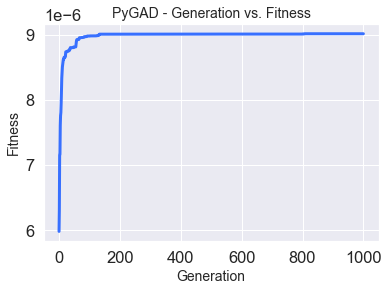

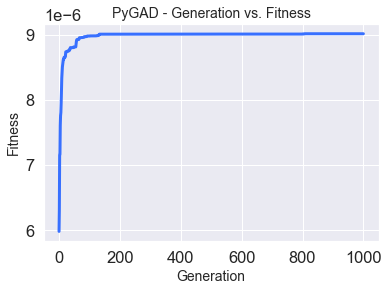

In [46]:
geneticAlgorithm.plot_fitness() 

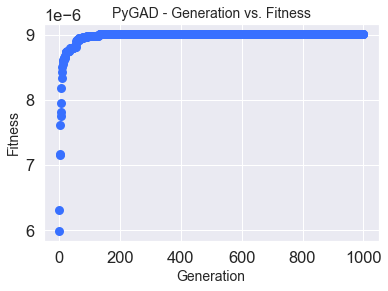

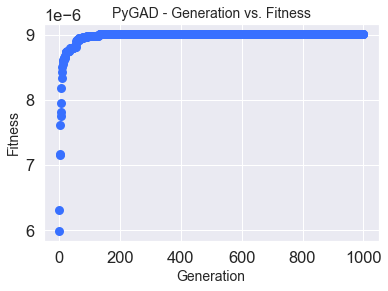

In [47]:
geneticAlgorithm.plot_fitness(plot_type="scatter") 

In [48]:
# Solution
solution, solutionFitness, solutionIndex = geneticAlgorithm.best_solution()
# Best solution
print('Parameters of the best solution: \n{solution}'.format(
    solution = solution.reshape(k, len(solution) // k)
    )
)
# Fitness value for best solution
print('Fitness value of the best solution: {solutionFit}'.format(
    solutionFit = solutionFitness
    )
)
# Index for best solution
# print('Index of the best solution: {solutionIndex}'.format(
#     solutionIndex = solutionIndex
#     )
# )

print("Best solution found after {gen} generations".format(gen=geneticAlgorithm.best_solution_generation))

Parameters of the best solution: 
[[ 0.64544361  0.7733775   0.26041654]
 [-0.35014371 -0.30129918 -0.1626909 ]
 [ 0.69035854 -0.44146503  0.00352227]
 [-0.39818256  0.706048    0.92672856]
 [ 0.29774998  2.1689441   1.90595333]]
Fitness value of the best solution: 9.016350391441666e-06
Best solution found after 924 generations


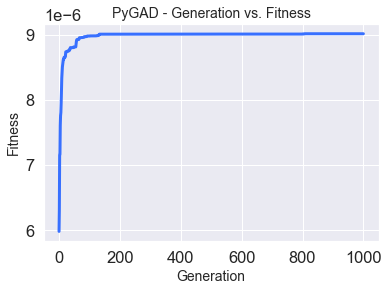

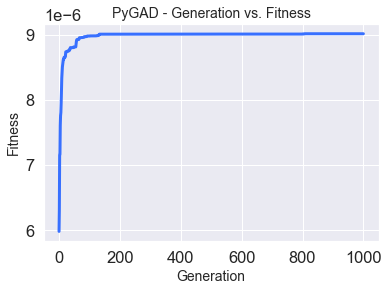

In [49]:
# Shows how the fitness evolves by generation.
geneticAlgorithm.plot_fitness() 

In [50]:
# Final centroids
centroids = solution.reshape(k, len(solution) // k)
# Finding the distance between centroids and all data points
distances = cdist(X_scaled_df, centroids, 'euclidean')
# Centroid with the minimum Distance
points = np.array([np.argmin(i) for i in distances])

In [51]:
# Global Optimal Centroids
centroids_df = pd.DataFrame(centroids,columns = ['X','Y','Z'])
centroids_df

,X,Y,Z
0,0.645444,0.773378,0.260417
1,-0.350144,-0.301299,-0.162691
2,0.690359,-0.441465,0.003522
3,-0.398183,0.706048,0.926729
4,0.297750,2.168944,1.905953


In [52]:
centroids_df.to_csv('centroids_df_proposed.csv',index=False)

In [53]:
# Centroids in array
solution.reshape(k, len(solution) // k)                 #(5,15//5)

array([[ 0.64544361,  0.7733775 ,  0.26041654],
       [-0.35014371, -0.30129918, -0.1626909 ],
       [ 0.69035854, -0.44146503,  0.00352227],
       [-0.39818256,  0.706048  ,  0.92672856],
       [ 0.29774998,  2.1689441 ,  1.90595333]])

In [54]:
Cluster_number = pd.DataFrame(points,columns=['Clusters'])
Cluster_number.value_counts()

Clusters
2           40836
1           38551
0           14219
3           12471
4            8898
dtype: int64

In [55]:
result_df1 = pd.concat([X_scaled_df,Cluster_number],axis=1)
result_df1

,Recency,Frequency,Monetary,Clusters
0,-0.333986,-0.571299,-0.396089,1
1,-1.030698,-0.571299,-1.684829,1
2,0.428228,-0.571299,-0.775291,2
3,0.451973,-0.571299,-0.321162,2
4,-1.891066,1.378636,1.295904,3
...,...,...,...,...
114970,0.016199,-0.571299,0.218767,1
114971,-0.515444,-0.571299,0.241323,1
114972,0.004236,-0.571299,0.794027,2
114973,-2.190472,-0.571299,0.809631,1


In [56]:
rfm_inverse_transform

,Recency,Frequency,Monetary
0,125.0,1.0,99.33
1,64.0,1.0,24.39
2,260.0,1.0,65.71
3,266.0,1.0,107.78
4,28.0,3.0,627.74
...,...,...,...
114970,175.0,1.0,194.11
114971,105.0,1.0,198.94
114972,173.0,1.0,363.31
114973,21.0,1.0,369.54


In [57]:
rfm_inverse_transform['Clusters'] = result_df1['Clusters']
rfm_inverse_transform

,Recency,Frequency,Monetary,Clusters
0,125.0,1.0,99.33,1
1,64.0,1.0,24.39,1
2,260.0,1.0,65.71,2
3,266.0,1.0,107.78,2
4,28.0,3.0,627.74,3
...,...,...,...,...
114970,175.0,1.0,194.11,1
114971,105.0,1.0,198.94,1
114972,173.0,1.0,363.31,2
114973,21.0,1.0,369.54,1


In [ ]:
rfm_inverse_transform.to_csv('rfm_inverse_transform_new.csv',index = False)
X_scaled_df.to_csv('X_scaled_df_new.csv',index = False)
rfm_log.to_csv('rfm_log_new.csv',index = False)

## Visualisation of clusters

In [58]:
# input matrix for segmentation
x = result_df1[['Recency','Frequency','Monetary']].values
x

array([[-0.33398565, -0.57129895, -0.39608904],
       [-1.03069765, -0.57129895, -1.68482942],
       [ 0.42822847, -0.57129895, -0.77529059],
       ...,
       [ 0.00423604, -0.57129895,  0.79402727],
       [-2.19047189, -0.57129895,  0.80963095],
       [ 0.45587818, -0.57129895,  0.20672705]])

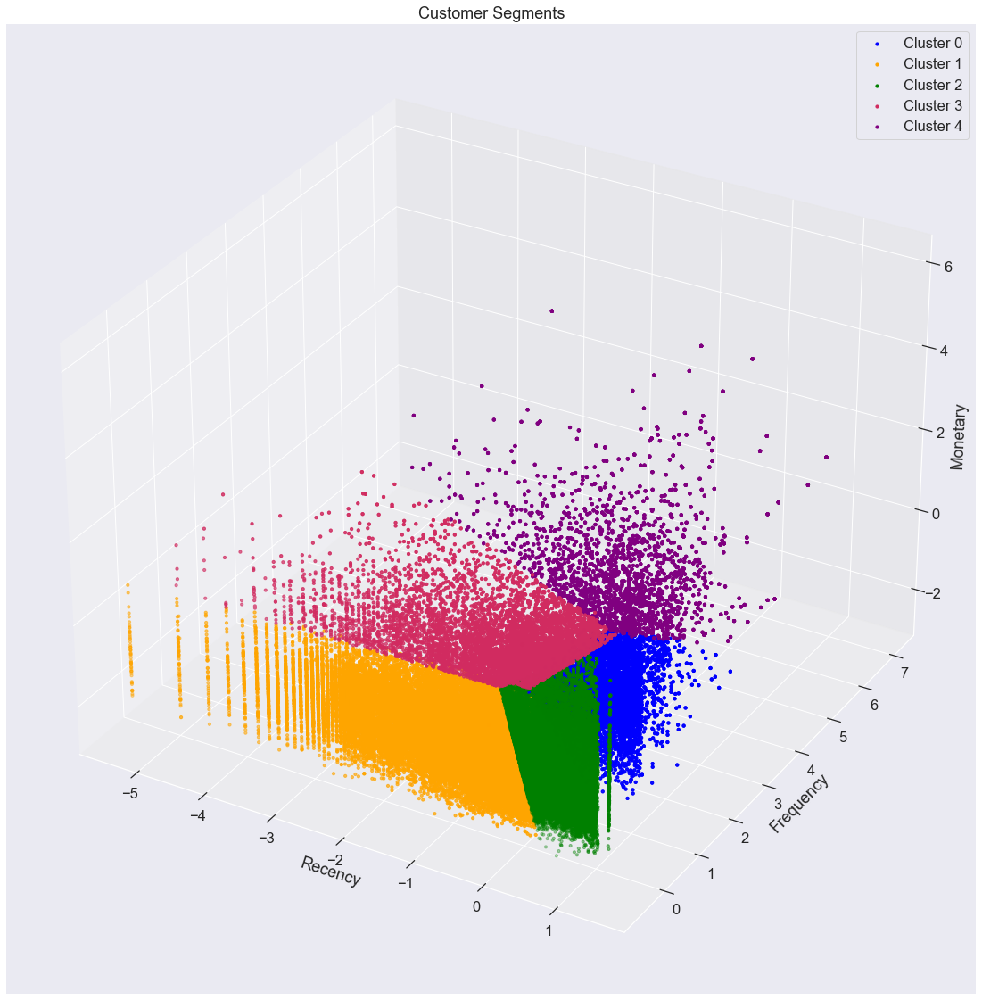

In [59]:
fig = plt.figure(figsize=(20, 20))
ax = fig.add_subplot(111, projection='3d')

xs = result_df1.Recency
ys = result_df1.Frequency
zs = result_df1.Monetary

for cluster_idx in range(5):
    cluster_x = centroids_df.values[cluster_idx][0]
    cluster_y = centroids_df.values[cluster_idx][1]
    cluster_z = centroids_df.values[cluster_idx][2]
    ax.scatter(cluster_x, cluster_y,cluster_z,s=20,color='black')

ax.scatter(x[points == 0,0],x[points == 0,1],x[points == 0,2], s=10, color = 'blue', label = "Cluster 0")
ax.scatter(x[points == 1,0],x[points == 1,1],x[points == 1,2], s=10, color = 'orange', label = "Cluster 1")
ax.scatter(x[points == 2,0],x[points == 2,1],x[points == 2,2], s=10, color = 'green', label = "Cluster 2")
ax.scatter(x[points == 3,0],x[points == 3,1],x[points == 3,2], s=10, color = '#D12B60', label = "Cluster 3")
ax.scatter(x[points == 4,0],x[points == 4,1],x[points == 4,2], s=10, color = 'purple', label = "Cluster 4")

ax.set_xlabel('Recency')
ax.set_ylabel('Frequency')
ax.set_zlabel('Monetary')
ax.set_title('Customer Segments')

ax.legend()

plt.show()

In [60]:
# 3d scatterplot using plotly
Scene = dict(xaxis = dict(title  = 'Recency'),yaxis = dict(title  = 'Frequency'),zaxis = dict(title  = 'Monetary'))

labels = points
trace1 = go.Scatter3d(x=x[points == 0,0], y=x[points == 0,1], z=x[points == 0,2],name='Cluster 0',mode='markers',marker=dict(line=dict(color= 'black',width = 1)))
trace2 = go.Scatter3d(x=x[points == 1,0], y=x[points == 1,1], z=x[points == 1,2],name='Cluster 1', mode='markers',marker=dict(line=dict(color= 'black',width = 1)))
trace3 = go.Scatter3d(x=x[points == 2,0], y=x[points == 2,1], z=x[points == 2,2],name='Cluster 2', mode='markers',marker=dict(line=dict(color= 'black',width = 1)))
trace4 = go.Scatter3d(x=x[points == 3,0], y=x[points == 3,1], z=x[points == 3,2],name='Cluster 3', mode='markers',marker=dict(line=dict(color= 'black',width = 1)))
trace5 = go.Scatter3d(x=x[points == 4,0], y=x[points == 4,1], z=x[points == 4,2],name='Cluster 4', mode='markers',marker=dict(line=dict(color= 'black',width = 1)))



layout = go.Layout(title = "Customer Segments",margin=dict(l=0,r=0),scene = Scene,height = 800,width = 800)

data = [trace1,trace2,trace3,trace4,trace5]

fig = go.Figure(data = data, layout = layout)


fig.show()

In [61]:
model = KMeans(n_clusters=5, init='random', random_state=101)

# scaling the data to normalize
model = model.fit(X_scaled_df)

# fitted labels for clusters -- the first cluster has label 0, and the second has label 1.
y_kmeans = model.labels_

In [62]:
type(y_kmeans)

numpy.ndarray

In [63]:
rfm_inverse_transform['K-means_Clusters'] = pd.DataFrame(y_kmeans,columns=['K-means_Clusters'])
rfm_inverse_transform

,Recency,Frequency,Monetary,Clusters,K-means_Clusters
0,125.0,1.0,99.33,1,2
1,64.0,1.0,24.39,1,2
2,260.0,1.0,65.71,2,2
3,266.0,1.0,107.78,2,2
4,28.0,3.0,627.74,3,4
...,...,...,...,...,...
114970,175.0,1.0,194.11,1,1
114971,105.0,1.0,198.94,1,1
114972,173.0,1.0,363.31,2,1
114973,21.0,1.0,369.54,1,3


In [64]:
from fcmeans import FCM

fcm = FCM(n_clusters=5,m=2,error=0.005,max_iter=100)
fcm.fit(X_scaled_df.to_numpy())

# outputs
fcm_centers = fcm.centers
fcm_labels = fcm.predict(X_scaled_df.to_numpy())

In [65]:
fcm_centers

array([[-1.722711  , -0.42009046, -0.31241872],
       [ 0.45280053, -0.51989866, -0.87093139],
       [ 0.33168147, -0.49866273,  0.0589016 ],
       [ 0.0814907 ,  2.04840516,  1.81550529],
       [ 0.26752121,  0.71583808,  0.60589025]])

In [66]:
centroids_df_fcm = pd.DataFrame(fcm_centers,columns = ['X','Y','Z'])
centroids_df_fcm

,X,Y,Z
0,-1.722711,-0.420090,-0.312419
1,0.452801,-0.519899,-0.870931
2,0.331681,-0.498663,0.058902
3,0.081491,2.048405,1.815505
4,0.267521,0.715838,0.605890


In [67]:
rfm_inverse_transform['FCM_Clusters'] = pd.DataFrame(fcm_labels, columns = ['FCM_Clusters'])
rfm_inverse_transform

,Recency,Frequency,Monetary,Clusters,K-means_Clusters,FCM_Clusters
0,125.0,1.0,99.33,1,2,2
1,64.0,1.0,24.39,1,2,0
2,260.0,1.0,65.71,2,2,1
3,266.0,1.0,107.78,2,2,2
4,28.0,3.0,627.74,3,4,3
...,...,...,...,...,...,...
114970,175.0,1.0,194.11,1,1,2
114971,105.0,1.0,198.94,1,1,2
114972,173.0,1.0,363.31,2,1,2
114973,21.0,1.0,369.54,1,3,0


<AxesSubplot:xlabel='Clusters', ylabel='Recency'>

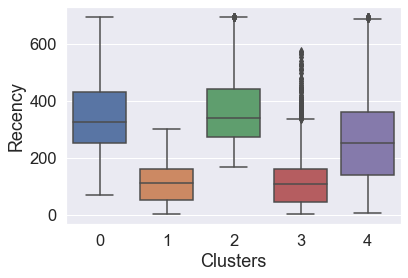

In [68]:
sns.boxplot(x='Clusters', y='Recency', data=rfm_inverse_transform)

<AxesSubplot:xlabel='K-means_Clusters', ylabel='Recency'>

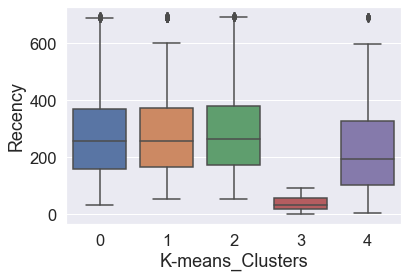

In [69]:
sns.boxplot(x='K-means_Clusters', y='Recency', data=rfm_inverse_transform)

<AxesSubplot:xlabel='FCM_Clusters', ylabel='Recency'>

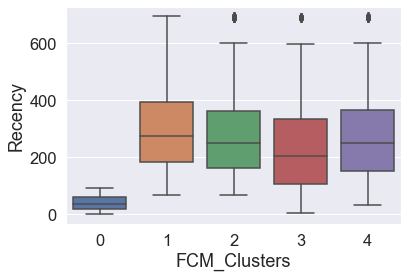

In [70]:
sns.boxplot(x='FCM_Clusters', y='Recency', data=rfm_inverse_transform)

In [71]:
rfm_inverse_transform.to_csv('rfm_inverse_transform_all_results.csv',index = False)

In [72]:
rfm_inverse_transform.columns

Index(['Recency', 'Frequency', 'Monetary', 'Clusters', 'K-means_Clusters',
       'FCM_Clusters'],
      dtype='object')

## Performace Evaluation

In [85]:
y_ga = result_df1['Clusters']
y_kmeans = df2['K-means_Clusters']
y_fcm = df2['FCM_Clusters']

In [74]:
X = X_scaled_df

In [75]:
X_scaled_df

,Recency,Frequency,Monetary
0,-0.333986,-0.571299,-0.396089
1,-1.030698,-0.571299,-1.684829
2,0.428228,-0.571299,-0.775291
3,0.451973,-0.571299,-0.321162
4,-1.891066,1.378636,1.295904
...,...,...,...
114970,0.016199,-0.571299,0.218767
114971,-0.515444,-0.571299,0.241323
114972,0.004236,-0.571299,0.794027
114973,-2.190472,-0.571299,0.809631


In [81]:
df2 = pd.read_csv('rfm_inverse_transform_all_results.csv')

In [82]:
df2

,Recency,Frequency,Monetary,Clusters,K-means_Clusters,FCM_Clusters
0,125.0,1.0,99.33,1,2,2
1,64.0,1.0,24.39,1,2,0
2,260.0,1.0,65.71,2,2,1
3,266.0,1.0,107.78,2,2,2
4,28.0,3.0,627.74,3,4,3
...,...,...,...,...,...,...
114970,175.0,1.0,194.11,1,1,2
114971,105.0,1.0,198.94,1,1,2
114972,173.0,1.0,363.31,2,1,2
114973,21.0,1.0,369.54,1,3,0


In [88]:
results = pd.read_csv('dbi_si_scores-Copy1.csv')
results

,Unnamed: 0,Methods,DBI,SI
0,0,K-Means,1.036,0.312
1,1,Fuzzy C-Means,1.070,0.303
2,2,Proposed,1.000,0.331


A good performance is measured by a lower value of DBI and higher value of SC. It can be seen that the scores of the proposed method on DBI is lower compared to other methods, and the SC for the proposed technique is higher than the compared methods. As a result, the proposed approach outperforms other comparison methods.